https://github.com/Z-Zheng/ChangeOS

In [19]:
# changeos has four APIs
# (e.g., 'list_available_models', 'from_name', 'visualize', 'demo_data')
import changeos
import matplotlib.pyplot as plt

In [20]:
import rasterio as rio
import geopandas as gpd
import fiona
import os
import pickle
# enable kml file reading for geopandas
from shapely.geometry import box, Polygon
import pandas as pd
import numpy as np
import leafmap.foliumap as leafmap # use folium backend
import rioxarray as rioxr
import matplotlib.pyplot as plt
from typing import List, Union, Dict
from pathlib import Path
fiona.drvsupport.supported_drivers['KML'] = 'rw'
import logging
pd.options.display.max_columns = 50
from src.rs_processing.processing import histogram_alignment

In [21]:
from src.config import *
from src.io.utils_io import load_maxar_items, load_rs_path_toy, load_roi_town, check_dir, make_path, save_pickle, load_pickle
from src.stac.utils_stac import get_nearest_match_geometry_view
from src.utils import create_bbox
from src.rs_processing.processing import crop_rs_on_shape

In [22]:
logging.basicConfig()
logger = logging.getLogger(__name__)
logger.setLevel(logging.INFO)

In [23]:
date_event = '2023-09-09'

### ChangeOS on maxar images

In [6]:
name = "Tafeghaghte"

In [7]:
def list_file_dir(*path):
    dir = os.path.join(*path)
    return [os.path.join(dir, _) for _ in os.listdir(dir)]

In [8]:
after_list = [_ for _ in list_file_dir(out_dir_path, name, "after") if _.endswith(".tif")]
before_list = [_ for _ in list_file_dir(out_dir_path, name, "before") if _.endswith(".tif")]

NameError: name 'out_dir_path' is not defined

In [28]:
after_list

['/home/rustt/Documents/Projects/building_damage/Data/processed/Tafeghaghte/after/10300100ED11EA00-visual.tif',
 '/home/rustt/Documents/Projects/building_damage/Data/processed/Tafeghaghte/after/10300500E4F92300-visual.tif',
 '/home/rustt/Documents/Projects/building_damage/Data/processed/Tafeghaghte/after/crop_256_10300100ED11EA00-visual.tif',
 '/home/rustt/Documents/Projects/building_damage/Data/processed/Tafeghaghte/after/crop_128_10300100ED11EA00-visual.tif']

In [29]:
sorted(before_list)

['/home/rustt/Documents/Projects/building_damage/Data/processed/Tafeghaghte/before/10400100405FEB00-visual.tif',
 '/home/rustt/Documents/Projects/building_damage/Data/processed/Tafeghaghte/before/10400100405FEB00-visual_reproOTB.tif',
 '/home/rustt/Documents/Projects/building_damage/Data/processed/Tafeghaghte/before/1040010045AE4B00-visual.tif',
 '/home/rustt/Documents/Projects/building_damage/Data/processed/Tafeghaghte/before/10400100797DAC00-visual.tif',
 '/home/rustt/Documents/Projects/building_damage/Data/processed/Tafeghaghte/before/crop_10400100405FEB00-visual.tif',
 '/home/rustt/Documents/Projects/building_damage/Data/processed/Tafeghaghte/before/crop_128_10400100405FEB00-visual.tif',
 '/home/rustt/Documents/Projects/building_damage/Data/processed/Tafeghaghte/before/crop_128_crop_256_10400100405FEB00-visual.tif',
 '/home/rustt/Documents/Projects/building_damage/Data/processed/Tafeghaghte/before/crop_256_10400100405FEB00-visual.tif',
 '/home/rustt/Documents/Projects/building_dama

In [32]:
def crop_rs_on_shape(rs_path: str, shape: Union[Polygon, List], out_path: str):
    """
    Crop raster from shapely geometry shape

    - add check crs equality
    - clip_box with rioxarray => pyproj CRS error
    
    """
    if not isinstance(shape, list):
        shape = [shape]
        
    with rio.open(rs_path) as src:
        out_image, out_transform = rio.mask.mask(src, shape, crop=True)
        out_meta = src.meta
    
        out_meta.update({"driver": "GTiff",
                     "height": out_image.shape[1],
                     "width": out_image.shape[2],
                     "transform": out_transform})
    
        with rio.open(out_path, "w", **out_meta) as dest:
            dest.write(out_image)

In [33]:
def get_crop_center_box(rs_path, out_path, l_side=256):
    with rio.open(rs_path) as src:
        bbox_coords  = (
            src.bounds.left, 
            src.bounds.bottom,
            src.bounds.right,
            src.bounds.top,
        )
        centroid = gpd.GeoDataFrame(geometry=[box(*bbox_coords)], crs=CRS).centroid 

    bbox = box(*centroid.buffer(l_side/(2*0.34)).total_bounds)
    
    crop_rs_on_shape(rs_path, bbox, out_path)
    return bbox

In [34]:
# easier : try to crop on pixels sizes/ number

In [35]:
l_side = [64, 128, 256, 512, 768, 1024, 1280, 1536]

crop_rs = {}

for size in l_side:
    
    crop_rs[size] = {}
    
    for img_path, temp in zip([before_list, after_list], ["before", "after"]): 
        
    

        """
        
        out_path = make_path(f"crop_{size}_{Path(img_path[0]).stem}.tif", 
                             out_dir_path, 
                             name, 
                             temp)

        res = get_crop_center_box(img_path[0], 
                                  out_path=out_path, 
                                  l_side=size)

        """
        # take the first img for now
        img_path = sorted(img_path)
        rs_arr = rioxr.open_rasterio(img_path[1]).data        
        crop_rs[size][temp] = rs_arr[:, 
                                (rs_arr.shape[1] // 2) - (size//2):(rs_arr.shape[1] // 2) + (size//2), 
                                (rs_arr.shape[2] // 2) - (size//2):(rs_arr.shape[2] // 2) + (size//2), 
                                    ]
        

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


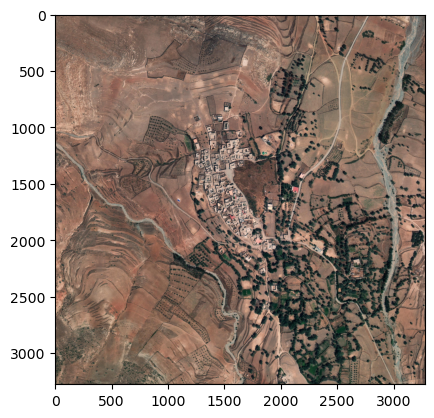

In [53]:
plt.imshow(img_before.data.transpose(1,2,0) / 255, cmap="grey")

<Axes: >

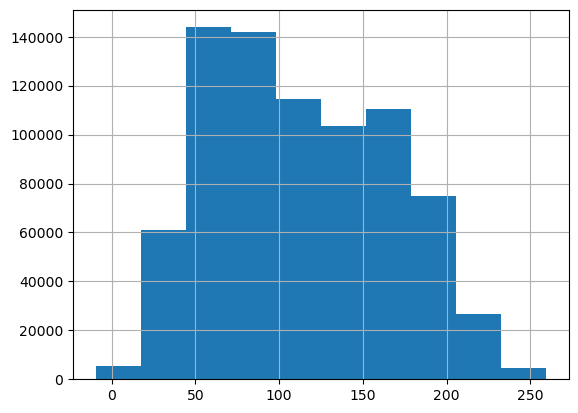

In [48]:
pd.Series(crop_rs[512]["before"].flatten()).hist()

#### Apply changeos

In [24]:
# constructing ChangeOS model
# support 'changeos_r18', 'changeos_r34', 'changeos_r50', 'changeos_r101'
model = changeos.from_name('changeos_r34') # take 'changeos_r101' as example

```python
l_side = 128
pre_path = make_path(f"crop_{l_side}_10400100405FEB00-visual.tif", out_dir_path, name, "before")
post_path = make_path(f"crop_{l_side}_10300100ED11EA00-visual.tif", out_dir_path, name, "after")

pre_img = rioxr.open_rasterio(pre_path).data.transpose(1, 2, 0)
post_img = rioxr.open_rasterio(post_path).data.transpose(1, 2, 0)
```

In [39]:
img_repro = '/home/rustt/Documents/Projects/building_damage/Data/processed/Tafeghaghte/before/10400100405FEB00-visual_reproOTB.tif'
img_before = rioxr.open_rasterio(img_repro)

https://stackoverflow.com/questions/69027829/how-to-add-row-titles-to-the-following-the-matplotlib-code

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


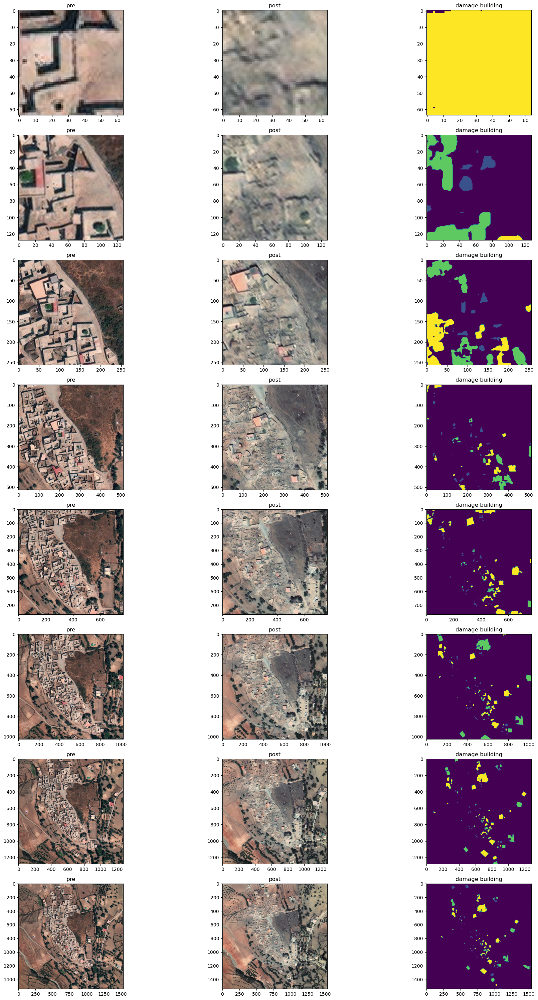

In [54]:
n_col = 3
fig, axes = plt.subplots(len(l_side), n_col, figsize=(20, 30))
axes = axes.ravel()
l_side = [64, 128, 256, 512, 768, 1024, 1280, 1536]
n_curr=0

for i, size in enumerate(l_side):
        
    pre_img = crop_rs[size]["before"].transpose(1, 2,  0)
    post_img = crop_rs[size]["after"].transpose(1, 2,  0)
    
    loc, dam = model(pre_img, post_img)
    
    for ii, name, img in zip(range(n_curr, n_curr+n_col), ["pre", "post", "damage building"], [pre_img/255, post_img, dam]):
        axes[ii].imshow(img)
        axes[ii].set_title(name)
    n_curr+=n_col
plt.tight_layout()

In [60]:
np.expand_dims(dam, axis=0).shape

(1, 512, 512)

### 128 size

In [26]:
l_side = 128
pre_img = crop_rs[l_side]["before"].transpose(1, 2,  0)
post_img = crop_rs[l_side]["after"].transpose(1, 2,  0)

In [30]:
print(pre_img.shape)

(256, 256, 3)


In [27]:
loc, dam = model(pre_img, post_img)

In [28]:
pd.Series(dam.flatten()).value_counts()

0    50140
3     5385
4     5157
1     4854
Name: count, dtype: int64

Text(0.5, 1.0, 'before event')

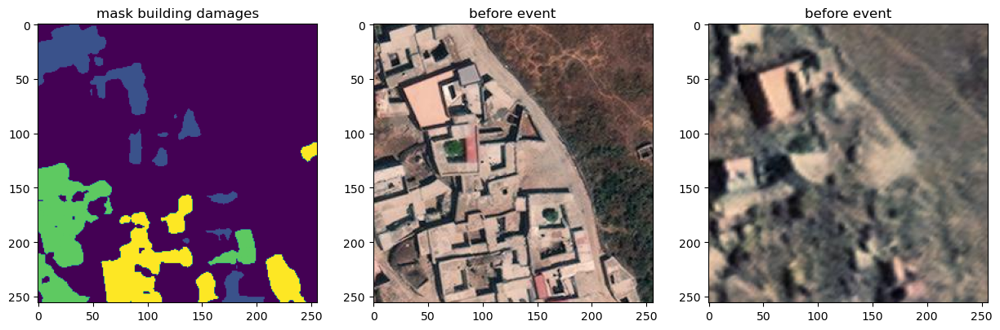

In [29]:
fig, axes = plt.subplots(1, 3, figsize=(15, 10))
axes[0].imshow(dam)
axes[0].set_title("mask building damages")
axes[1].imshow(pre_img)
axes[1].set_title("before event")
axes[2].imshow(post_img)
axes[2].set_title("before event")

### 256 size

In [31]:
l_side = 256
pre_img = crop_rs[l_side]["before"].transpose(1, 2,  0)
post_img = crop_rs[l_side]["after"].transpose(1, 2,  0)

In [33]:
print(pre_img.shape)

(512, 512, 3)


In [34]:
loc, dam = model(pre_img, post_img)

In [35]:
pd.Series(dam.flatten()).value_counts()

0    248073
4      9449
1      4108
3       514
Name: count, dtype: int64

Text(0.5, 1.0, 'before event')

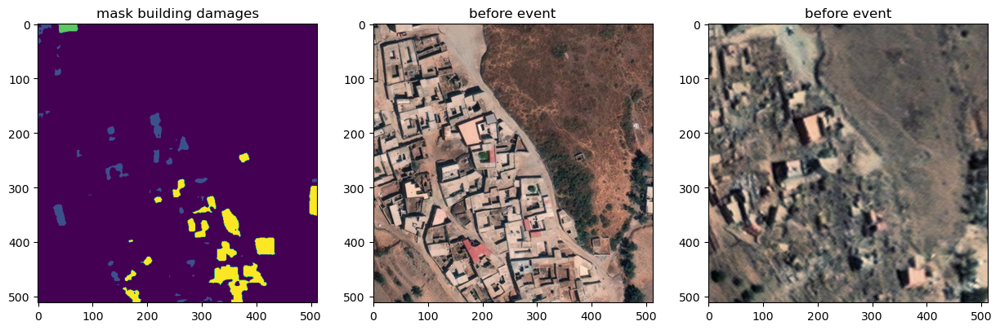

In [36]:
fig, axes = plt.subplots(1, 3, figsize=(15, 10))
axes[0].imshow(dam)
axes[0].set_title("mask building damages")
axes[1].imshow(pre_img)
axes[1].set_title("before event")
axes[2].imshow(post_img)
axes[2].set_title("before event")

* try on different sensor
* try on different scale

### Aligned Images

In [9]:
processed_dir_path

'/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed'

In [13]:
town = load_roi_town()

In [11]:
type_item = "visual"

In [15]:
town

,town_name,geometry
0,Adassil,POINT (547909.130 3441974.137)
1,Tafeghaghte,POINT (573971.703 3451595.559)
2,Mejdid,POINT (548561.849 3442843.085)
3,Amzi,POINT (575844.024 3451538.007)
4,Tinzert,POINT (594423.730 3451056.954)
5,Taroudant,POINT (512035.792 3371260.816)
6,Talat_Nyaaqoub,POINT (577944.644 3428729.694)
7,Tassouante,POINT (577087.931 3428348.098)


In [10]:
ls /home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/visual/Adassil/registration


after_200_shifted__global_10300500E4F91500-visual.hdr
after_200_shifted__global_10300500E4F91500-visual.tif
after_300_shifted__global_10300500E4F91500-visual.hdr
after_300_shifted__global_10300500E4F91500-visual.tif
after_500_shifted__local_10300500E4F91500-visual.hdr
after_500_shifted__local_10300500E4F91500-visual.tif
after_500_shifted__local_10300500E4F91500-visual.tif.aux.xml
before_200_104001004F028F00-visual.tif
before_300_104001004F028F00-visual.tif


In [11]:
model = changeos.from_name('changeos_r34') # take 'changeos_r101' as example

In [25]:
town_test = "Talat_Nyaaqoub"
type_item="visual"
s_buffer = 200
registration_path = Path(processed_dir_path, type_item, town_test)
#post_path = Path(registration_path, f"after_{s_buffer}_shifted__global_10300500E4F91500-visual.tif")
#pre_path = Path(registration_path, f"before_{s_buffer}_104001004F028F00-visual.tif")
pre_path = Path(registration_path, "registration", f"before_{s_buffer}_1040010077691A00-visual.tif")
post_path = Path(registration_path, f"{s_buffer}_after_10300500E4F92300-visual_rgsted.tif")

In [13]:
ls /home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/visual/Talat_Nyaaqoub/registration/before_200_1040010077691A00-visual.tif

/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/visual/Talat_Nyaaqoub/registration/before_200_1040010077691A00-visual.tif


In [14]:
pre_img

NameError: name 'pre_img' is not defined

In [15]:
ls /home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/visual/Talat_Nyaaqoub/registration/before_200_1040010077691A00-visual.tif

/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/visual/Talat_Nyaaqoub/registration/before_200_1040010077691A00-visual.tif


In [16]:
pre_img = rioxr.open_rasterio(pre_path).data.transpose(1, 2, 0)
post_img = rioxr.open_rasterio(post_path).data.transpose(1, 2, 0)

In [17]:
print(pre_img.shape)
print(post_img.shape)

(1311, 1312, 3)
(1311, 1312, 3)


In [18]:
loc, dam = model(pre_img, post_img)

ValueError: too many values to unpack (expected 2)

In [ ]:
pd.Series(dam.flatten()).value_counts()

### Try some stuff

In [58]:
import cv2

In [74]:
registration_path = Path(processed_dir_path, type_item, town_test)
#post_path = Path(registration_path, f"after_{s_buffer}_shifted__global_10300500E4F91500-visual.tif")
#pre_path = Path(registration_path, f"before_{s_buffer}_104001004F028F00-visual.tif")
pre_path = Path(registration_path, "registration", f"before_{s_buffer}_1040010077691A00-visual.tif")
post_path = Path(registration_path, f"{s_buffer}_after_10300500E4F92300-visual_rgsted.tif")

pre_img = rioxr.open_rasterio(pre_path).data.transpose(1, 2, 0)
post_img = rioxr.open_rasterio(post_path).data.transpose(1, 2, 0)

In [75]:
res_pre = cv2.Canny(pre_img,200,230)
res_post = cv2.Canny(post_img,200,230)

In [84]:
res_pre = cv2.GaussianBlur(pre_img, (15,15),0)
res_post = cv2.GaussianBlur(post_img, (15,15),0)

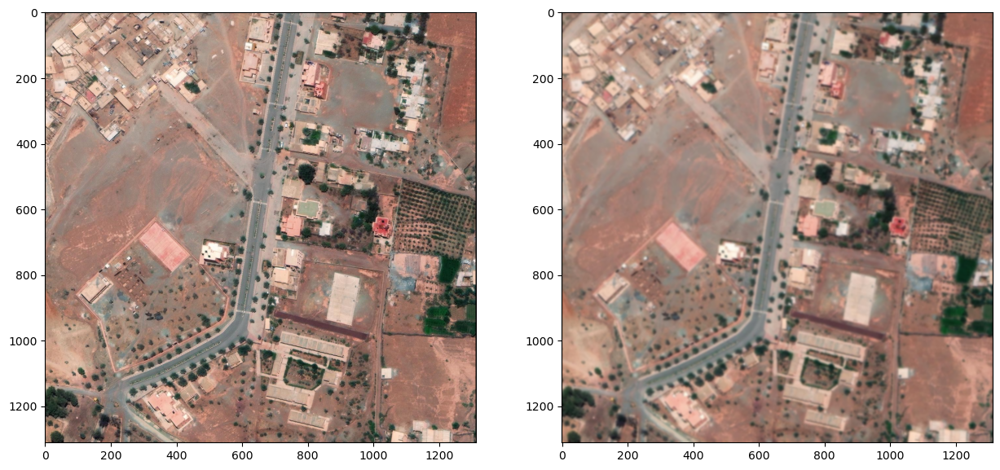

In [85]:
plt.figure(figsize=(15,10))
plt.subplot(1, 2, 1)
plt.imshow(pre_img)
plt.subplot(1, 2, 2)
plt.imshow(res_pre)

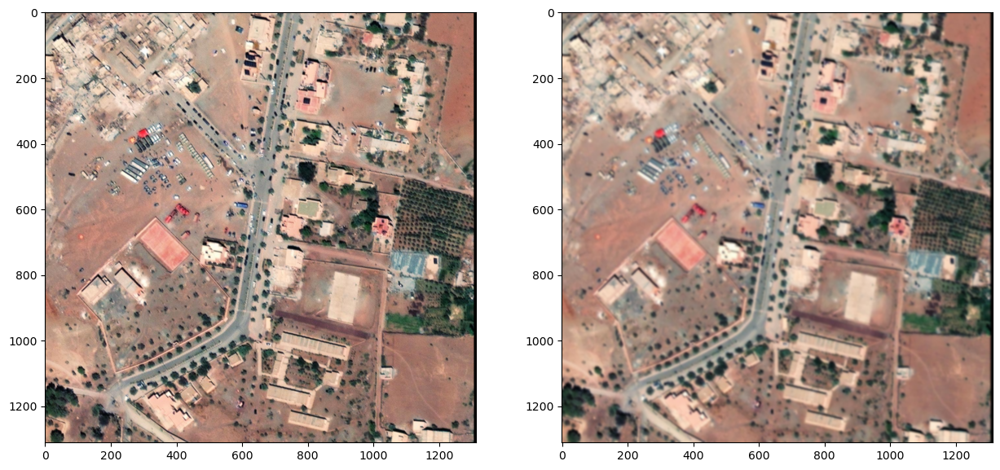

In [86]:
plt.figure(figsize=(15,10))
plt.subplot(1, 2, 1)
plt.imshow(post_img)
plt.subplot(1, 2, 2)
plt.imshow(res_post)

### Not registered images

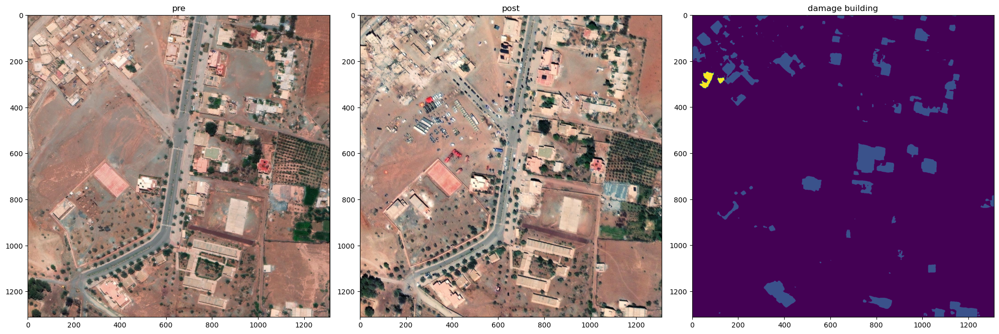

In [15]:
model = changeos.from_name('changeos_r18') # take 'changeos_r101' as example
pre_path = Path(interim_dir_path, type_item, town_test, "nearest", f"{s_buffer}_before_1040010077691A00-visual.tif")
post_path = Path(interim_dir_path, type_item, town_test, "nearest", f"{s_buffer}_after_10300500E4F92300-visual.tif")

pre_img = rioxr.open_rasterio(pre_path).data.transpose(1, 2, 0)
post_img = rioxr.open_rasterio(post_path).data.transpose(1, 2, 0)

loc, dam, _, dam_raw = model(pre_img, post_img)
#loc, dam = changeos.visualize(loc, dam)
plt.figure(figsize=(20,20))
for ii, name, img in zip(range(1, 3+1), ["pre", "post", "damage building"], [pre_img, post_img, dam]):
    plt.subplot(1, 3, ii)
    plt.imshow(img)
    plt.title(name)
plt.tight_layout()

In [18]:
dam_raw.shape

torch.Size([1, 5, 1312, 1312])

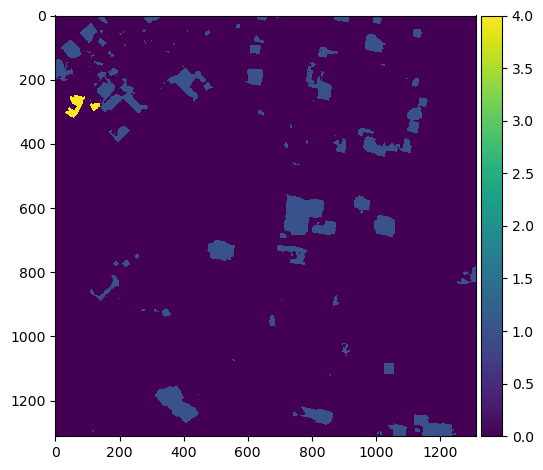

In [13]:
from skimage import io
io.imshow(dam)

In [23]:
np.where(dam > 0, 1, 0).shape

(1312, 1312, 3)

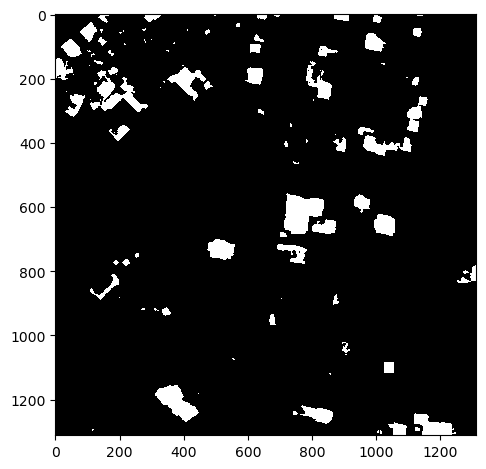

In [36]:
io.imshow(np.max(dam, axis=2))

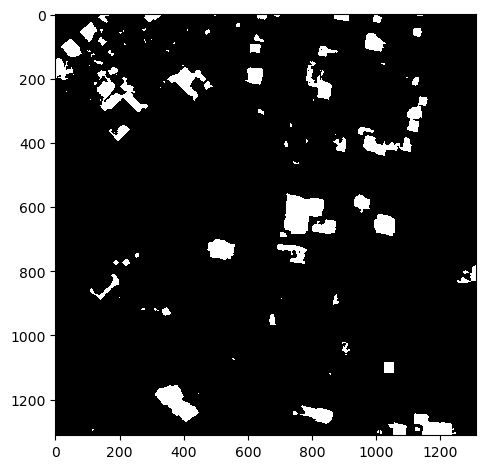

In [32]:
io.imshow(dam[:, :, 1])

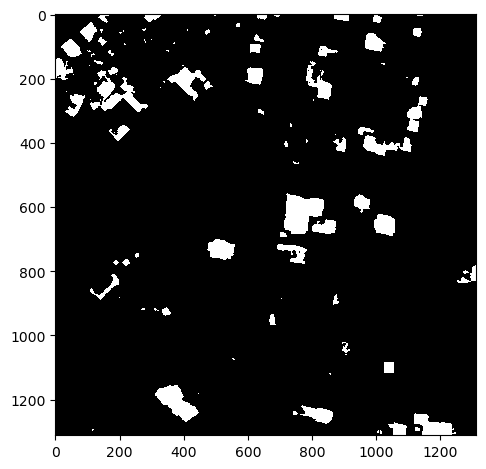

In [26]:
io.imshow(dam[:, :, 0])

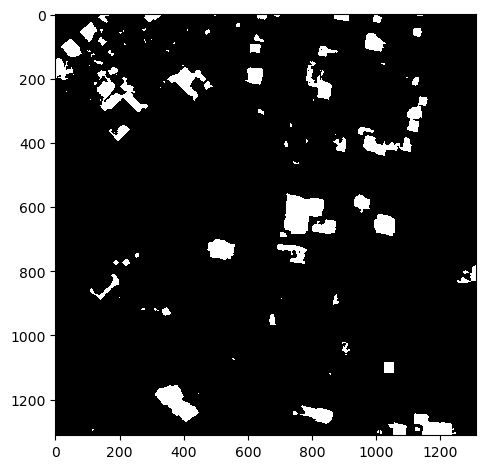

In [29]:
io.imshow(dam[:, :, 2])

In [157]:
pd.Series(dam.flatten()).value_counts()

0    1600316
1      98467
4      22561
Name: count, dtype: int64

In [151]:
ls /home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/interim/visual/Talat_Nyaaqoub/nearest/

200_after_10300500E4F92300-visual.tif           before/
200_after_10300500E4F92300-visual.tif.aux.xml   full_tiles/
200_before_1040010077691A00-visual.tif          nearest.png
200_before_1040010077691A00-visual.tif.aux.xml  test_eolearn/
after/


### Registered images

#### registration with LoFTR

In [8]:
registration_path = Path(processed_dir_path, type_item, town_test)
#post_path = Path(registration_path, f"after_{s_buffer}_shifted__global_10300500E4F91500-visual.tif")
#pre_path = Path(registration_path, f"before_{s_buffer}_104001004F028F00-visual.tif")
pre_path = Path(registration_path, "registration", f"before_{s_buffer}_1040010077691A00-visual.tif")
post_path = Path(registration_path, f"{s_buffer}_after_10300500E4F92300-visual_rgsted.tif")

pre_img = rioxr.open_rasterio(pre_path).data.transpose(1, 2, 0)
post_img = rioxr.open_rasterio(post_path).data.transpose(1, 2, 0)

post_img = histogram_alignment(post_img, pre_img)

loc, dam, _, _ = model(pre_img, post_img)
loc, dam = changeos.visualize(loc, dam)
plt.figure(figsize=(20,20))
for ii, name, img in zip(range(1, 3+1), ["pre", "post", "damage building"], [pre_img, post_img, dam]):
    plt.subplot(1, 3, ii)
    plt.imshow(img)
    plt.title(name)
plt.tight_layout()

NameError: name 'model' is not defined

In [38]:
pd.Series(dam.flatten()).value_counts()

0      4859960
255     304072
Name: count, dtype: int64

### Avec histogramme alignment

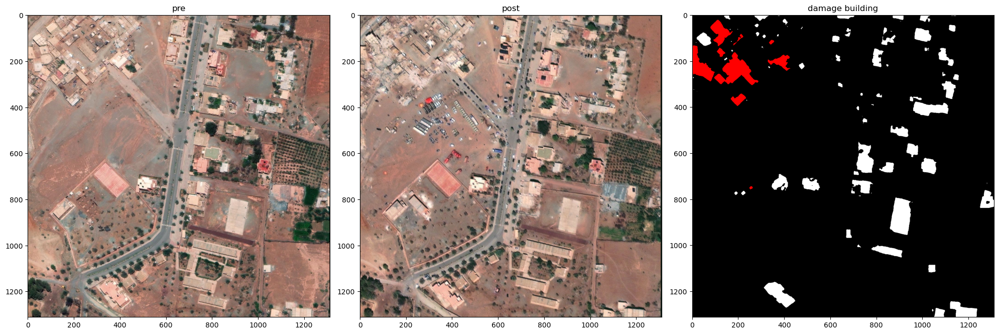

In [40]:
registration_path = Path(processed_dir_path, type_item, town_test)
#post_path = Path(registration_path, f"after_{s_buffer}_shifted__global_10300500E4F91500-visual.tif")
#pre_path = Path(registration_path, f"before_{s_buffer}_104001004F028F00-visual.tif")
pre_path = Path(registration_path, "registration", f"before_{s_buffer}_1040010077691A00-visual.tif")
post_path = Path(registration_path, f"{s_buffer}_after_10300500E4F92300-visual_rgsted.tif")

pre_img = rioxr.open_rasterio(pre_path).data.transpose(1, 2, 0)
post_img = rioxr.open_rasterio(post_path).data.transpose(1, 2, 0)

post_img = histogram_alignment(post_img, pre_img)

loc, dam = model(pre_img, post_img)
loc, dam = changeos.visualize(loc, dam)
plt.figure(figsize=(20,20))
for ii, name, img in zip(range(1, 3+1), ["pre", "post", "damage building"], [pre_img, post_img, dam]):
    plt.subplot(1, 3, ii)
    plt.imshow(img)
    plt.title(name)
plt.tight_layout()

Cela smeble mieux avec istogram alignement

In [41]:
ls /home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/visual/Talat_Nyaaqoub/registration/

after_200_shifted__global_10300500E4F92300-visual.hdr
after_200_shifted__global_10300500E4F92300-visual.tif
after_200_shifted__global_10300500E4F92300-visual.tif.aux.xml
after_300_shifted__global_10300500E4F92300-visual.hdr
after_300_shifted__global_10300500E4F92300-visual.tif
after_500_shifted__local_10300500E4F92300-visual.hdr
after_500_shifted__local_10300500E4F92300-visual.tif
after_500_shifted__local_10300500E4F92300-visual.tif.aux.xml
before_200_1040010077691A00-visual.tif
before_300_1040010077691A00-visual.tif


#### registration with arosics

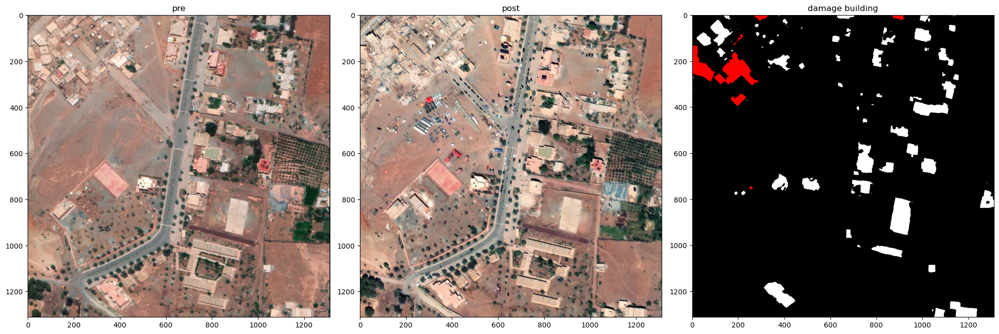

In [43]:
registration_path = Path(processed_dir_path, type_item, town_test)
#post_path = Path(registration_path, f"after_{s_buffer}_shifted__global_10300500E4F91500-visual.tif")
#pre_path = Path(registration_path, f"before_{s_buffer}_104001004F028F00-visual.tif")
pre_path = Path(interim_dir_path, type_item, town_test, "nearest","before", f"200_1040010077691A00-visual.tif")
post_path = Path(registration_path, "registration", f"after_200_shifted__global_10300500E4F92300-visual.tif")

pre_img = rioxr.open_rasterio(pre_path).data.transpose(1, 2, 0)
post_img = rioxr.open_rasterio(post_path).data.transpose(1, 2, 0)

loc, dam = model(pre_img, post_img)
loc, dam = changeos.visualize(loc, dam)
plt.figure(figsize=(20,20))
for ii, name, img in zip(range(1, 3+1), ["pre", "post", "damage building"], [pre_img, post_img, dam]):
    plt.subplot(1, 3, ii)
    plt.imshow(img)
    plt.title(name)
plt.tight_layout()

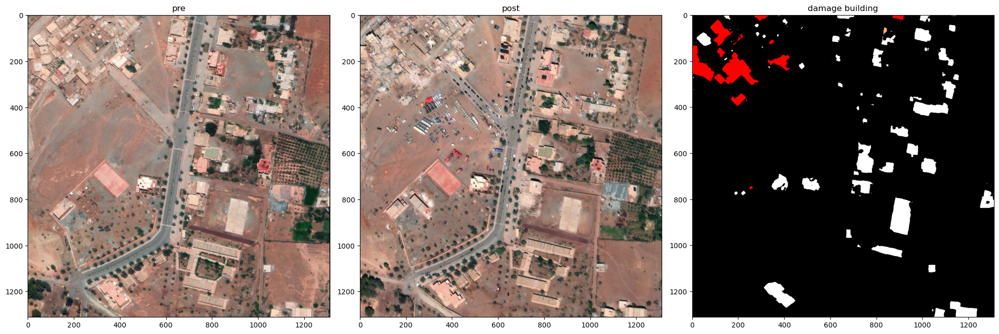

In [50]:
registration_path = Path(processed_dir_path, type_item, town_test)
#post_path = Path(registration_path, f"after_{s_buffer}_shifted__global_10300500E4F91500-visual.tif")
#pre_path = Path(registration_path, f"before_{s_buffer}_104001004F028F00-visual.tif")
pre_path = Path(interim_dir_path, type_item, town_test, "nearest","before", f"200_1040010077691A00-visual.tif")
post_path = Path(registration_path, "registration", f"after_200_shifted__global_10300500E4F92300-visual.tif")

pre_img = rioxr.open_rasterio(pre_path).data.transpose(1, 2, 0)
post_img = rioxr.open_rasterio(post_path).data.transpose(1, 2, 0)
post_img = histogram_alignment(post_img, pre_img)

loc, dam = model(pre_img, post_img)
loc, dam = changeos.visualize(loc, dam)
plt.figure(figsize=(20,20))
for ii, name, img in zip(range(1, 3+1), ["pre", "post", "damage building"], [pre_img, post_img, dam]):
    plt.subplot(1, 3, ii)
    plt.imshow(img)
    plt.title(name)
plt.tight_layout()

### Zoom

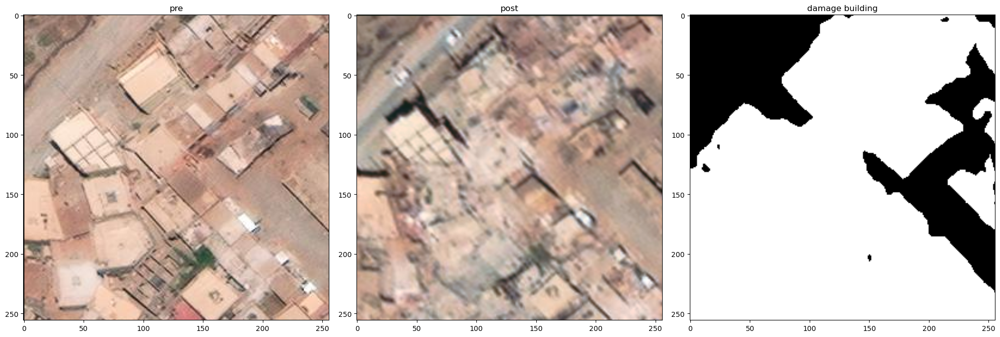

In [17]:
size = 256
pre_img = rioxr.open_rasterio(pre_path).data.transpose(1, 2, 0)
post_img = rioxr.open_rasterio(post_path).data.transpose(1, 2, 0)
post_img = histogram_alignment(post_img, pre_img)

pre_img = pre_img[:size, :size,:]
post_img = post_img[:size, :size,:]
loc, dam = model(pre_img, post_img)
loc, dam = changeos.visualize(loc, dam)
plt.figure(figsize=(20,20))
for ii, name, img in zip(range(1, 3+1), ["pre", "post", "damage building"], [pre_img, post_img, dam]):
    plt.subplot(1, 3, ii)
    plt.imshow(img)
    plt.title(name)
plt.tight_layout()

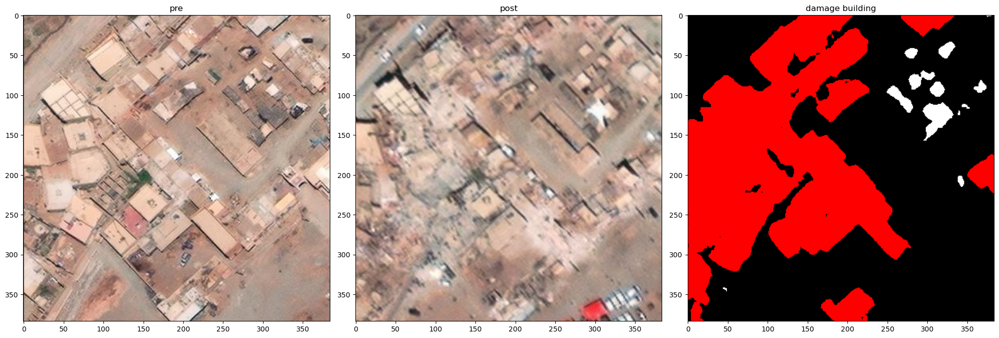

In [18]:
size = 384

pre_img = rioxr.open_rasterio(pre_path).data.transpose(1, 2, 0)
post_img = rioxr.open_rasterio(post_path).data.transpose(1, 2, 0)
post_img = histogram_alignment(post_img, pre_img)

pre_img = pre_img[:size, :size,:]
post_img = post_img[:size, :size,:]
loc, dam = model(pre_img, post_img)
loc, dam = changeos.visualize(loc, dam)
plt.figure(figsize=(20,20))
for ii, name, img in zip(range(1, 3+1), ["pre", "post", "damage building"], [pre_img, post_img, dam]):
    plt.subplot(1, 3, ii)
    plt.imshow(img)
    plt.title(name)
plt.tight_layout()

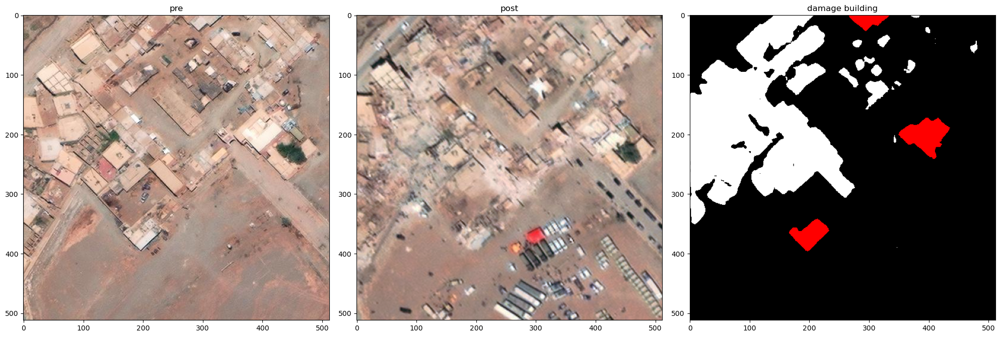

In [161]:
size = 512

pre_img = rioxr.open_rasterio(pre_path).data.transpose(1, 2, 0)
post_img = rioxr.open_rasterio(post_path).data.transpose(1, 2, 0)
post_img = histogram_alignment(post_img, pre_img)

pre_img = pre_img[:size, :size,:]
post_img = post_img[:size, :size,:]
loc, dam, l_raw, d_raw = model(pre_img, post_img)
loc, dam = changeos.visualize(loc, dam)
plt.figure(figsize=(20,20))
for ii, name, img in zip(range(1, 3+1), ["pre", "post", "damage building"], [pre_img, post_img, dam]):
    plt.subplot(1, 3, ii)
    plt.imshow(img)
    plt.title(name)
plt.tight_layout()

In [23]:
def detach(tensor): 
    return tensor.detach().numpy().squeeze()

In [67]:
l_raw_ = detach(l_raw)

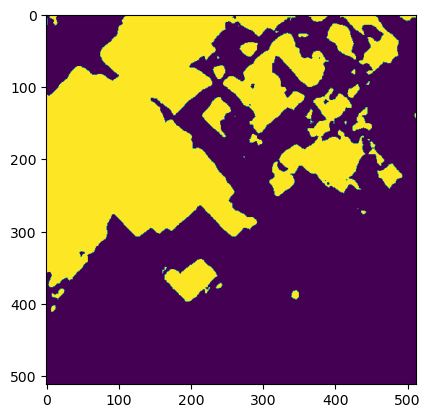

In [104]:
plt.imshow(l_raw_ > -5)

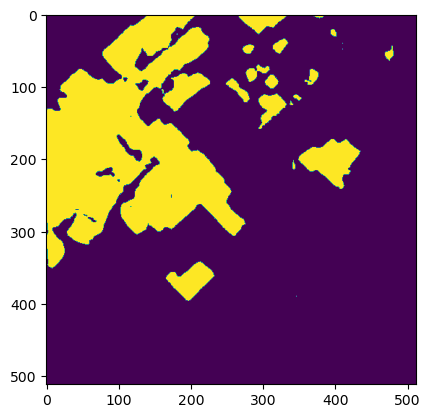

In [102]:
plt.imshow(l_raw_ > 0)

<Axes: >

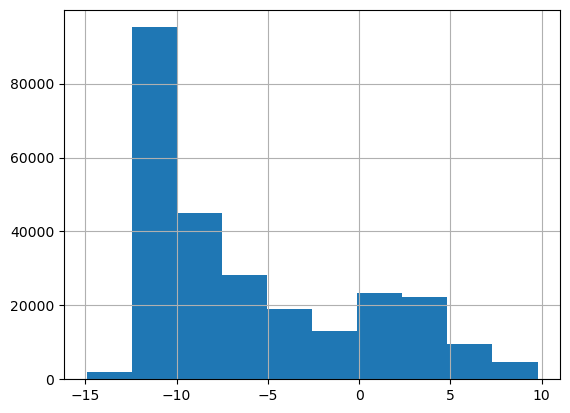

In [82]:
pd.Series(l_raw_.flatten()).hist()

In [71]:
from skimage import exposure

In [74]:
def spread_px_in_range(img: np.array, domain: dict) -> np.array:
    "etalement sur pour une range de pixels - c'est une normalisation"
    
    # min, max for img final
    m, M = domain["dest"][0],  domain["dest"][1]
    # min, max image origin - we cannot use min/max because have pixels deactivated by the mask
    m0, M0 = domain["origin"][0], domain["origin"][1]
    # appply normalisation == recadrage + etalement
    img_norm = m+(img - m0)*((M-m)/(M0-m0)) 

    return img_norm 

In [77]:
l_raw_s = spread_px_in_range(l_raw_, {"dest":(0, 1), "origin":(np.min(l_raw_), np.max(l_raw_))})

<Axes: >

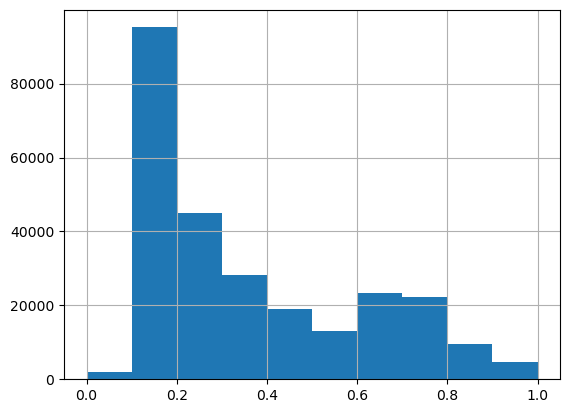

In [79]:
pd.Series(l_raw_s.flatten()).hist()

In [96]:
img_adapteq = exposure.equalize_adapthist(l_raw_s, clip_limit=0.3)

In [100]:
l_raw_s

array([[0.38856676, 0.3877012 , 0.38683572, ..., 0.45212185, 0.44916096,
        0.44620022],
       [0.39101982, 0.3901804 , 0.389341  , ..., 0.44097388, 0.43856704,
        0.4361603 ],
       [0.39347294, 0.39265963, 0.3918463 , ..., 0.42982587, 0.4279731 ,
        0.42612037],
       ...,
       [0.29707083, 0.2997179 , 0.30236495, ..., 0.18009418, 0.1891033 ,
        0.19811219],
       [0.30515903, 0.30837175, 0.31158444, ..., 0.18516058, 0.19422475,
        0.20328864],
       [0.31324703, 0.31702533, 0.32080367, ..., 0.19022682, 0.19934602,
        0.20846497]], dtype=float32)

In [98]:
img_adapteq.shape

(512, 512)

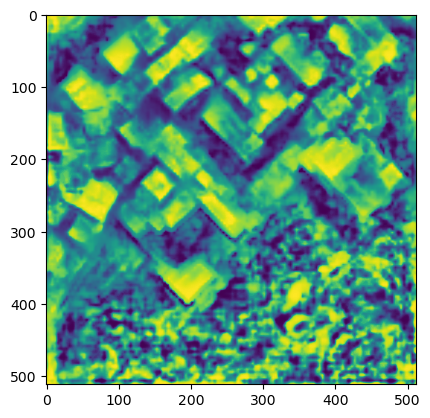

In [99]:
plt.imshow(img_adapteq)

<Axes: >

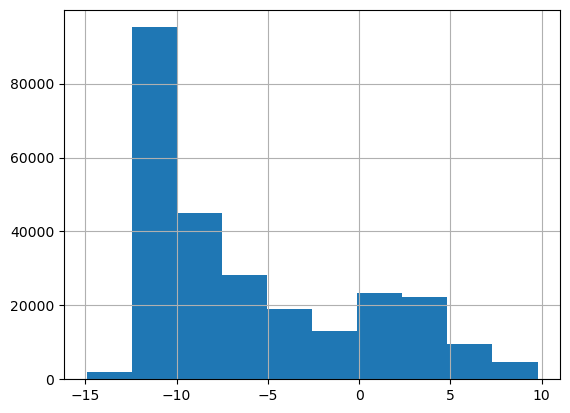

In [70]:
pd.Series(l_raw_.flatten()).hist()

In [27]:
d_raw.shape

torch.Size([1, 5, 512, 512])

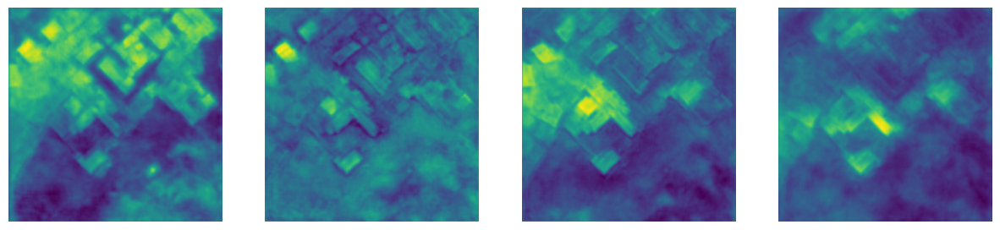

In [38]:
plt.figure(figsize=(15, 10))
for i in range(1, 5):
    plt.subplot(1, 4, i)
    plt.imshow(detach(d_raw)[i, :, :])
    plt.axis("off")

In [105]:
loc = (l_raw > 0.).cpu().squeeze(1).numpy()
dam = d_raw.argmax(dim=1).cpu().squeeze(1).numpy()

In [108]:
dam_ = detach(d_raw)

In [118]:
dam_.shape

(5, 512, 512)

In [111]:
np.mean(dam_, axis=0).shape

(512, 512)

In [120]:
dam_m = np.max(dam_, axis=0).reshape(dam_.shape[1:])

In [123]:
dam_m = spread_px_in_range(dam_m,{"dest":(0, 1), "origin":(np.min(dam_m), np.max(dam_m))})

In [145]:
from skimage.filters import threshold_otsu

<Axes: >

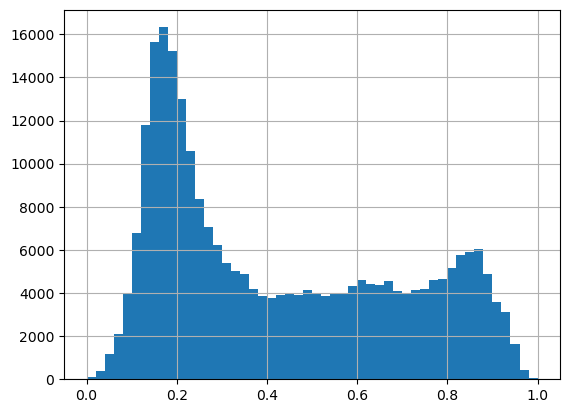

In [167]:
pd.Series((1-dam_m).flatten()).hist(bins=50)

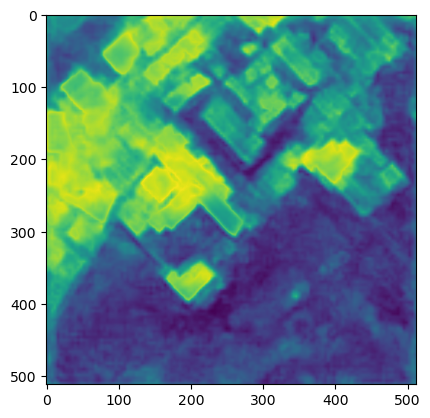

In [124]:
plt.imshow(1-dam_m)

In [157]:
th = threshold_otsu((1-dam_m))

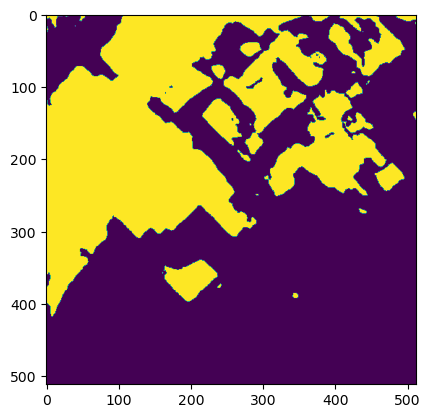

In [159]:
plt.imshow(((1-dam_m) > th))

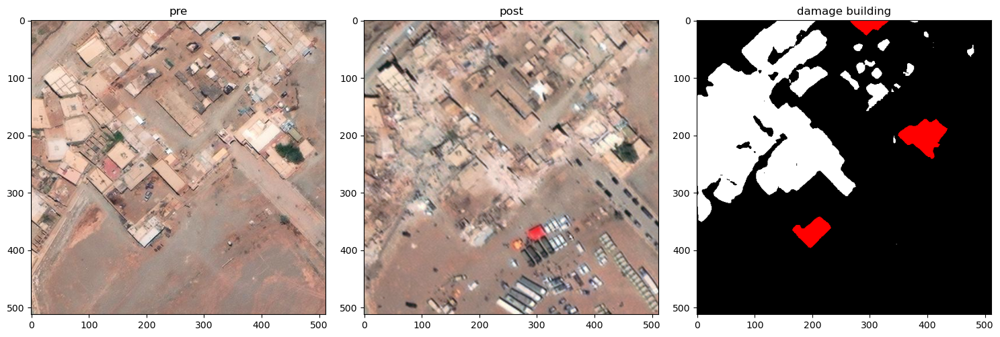

In [163]:
plt.figure(figsize=(15, 10))
for ii, name, img in zip(range(1, 3+1), ["pre", "post", "damage building"], [pre_img, post_img, dam]):
    plt.subplot(1, 3, ii)
    plt.imshow(img)
    plt.title(name)
plt.tight_layout()

In [125]:
from sklearn.cluster import KMeans

In [193]:
km = KMeans(3)
km.fit((1-dam_m).flatten().reshape(-1, 1))
pred_dam = km.predict((1-dam_m).flatten().reshape(-1, 1))

In [194]:
pred_dam.shape

(262144,)

In [195]:
dam_m.shape

(512, 512)

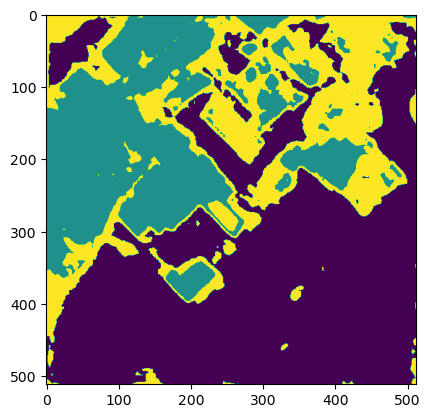

In [196]:
plt.imshow(pred_dam.reshape(dam_m.shape))

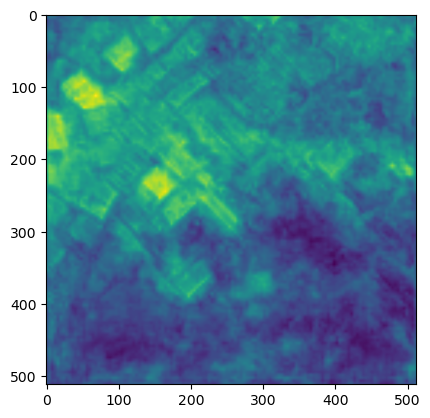

In [112]:
plt.imshow(np.mean(dam_, axis=0))

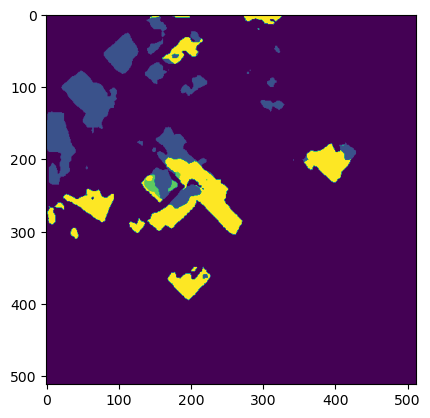

In [106]:
plt.imshow(dam.transpose(1, 2, 0))

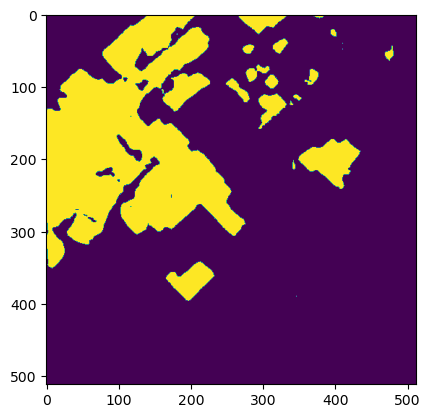

In [52]:
plt.imshow(loc.squeeze())

In [40]:
loc.shape

(1, 512, 512)

In [43]:
dam.shape

(1, 512, 512)

In [47]:
from skimage import measure
labeled_local, nums = measure.label(loc, connectivity=2, background=0, return_num=True)

In [49]:
labeled_local.shape

(1, 512, 512)

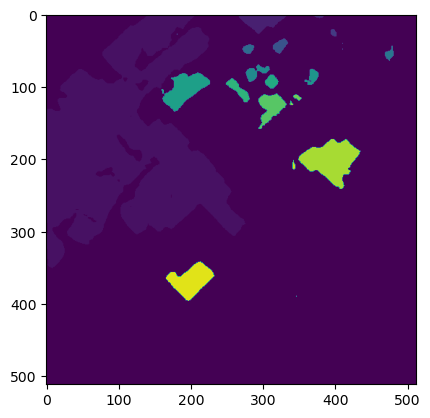

In [50]:
plt.imshow(labeled_local.squeeze())

### FasSam

In [173]:
from PIL import Image
import cv2

In [180]:
im_b = Image.open(pre_path)
im_a = Image.open(post_path)

town_test = "Talat_Nyaaqoub"
out_root = Path(f"/home/rustt/Documents/Projects/SAM-CD/datasets/test/{town_test}/")
out_b = str(out_root / "before"/ "before.png")
out_a = str(out_root / "after" / "after.png")

im_b.save(out_b, "PNG")
im_a.save(out_a, "PNG")

im_b = cv2.imread(out_b, cv2.IMREAD_COLOR)
im_a = cv2.imread(out_a, cv2.IMREAD_COLOR)

im_b = cv2.cvtColor(im_b, cv2.COLOR_BGR2RGB)
im_a = cv2.cvtColor(im_a, cv2.COLOR_BGR2RGB)

im_b = cv2.resize(im_b, (1024, 1024))
im_a = cv2.resize(im_a, (1024, 1024))

im_b = Image.fromarray(im_b)
im_a = Image.fromarray(im_a)

im_b.save(out_b, "PNG")
im_a.save(out_a, "PNG")

In [181]:
pred_sam = load_pickle(Path(f"/home/rustt/Documents/Projects/SAM-CD/datasets/eval/pred_{town_test}.pkl"))

<Axes: >

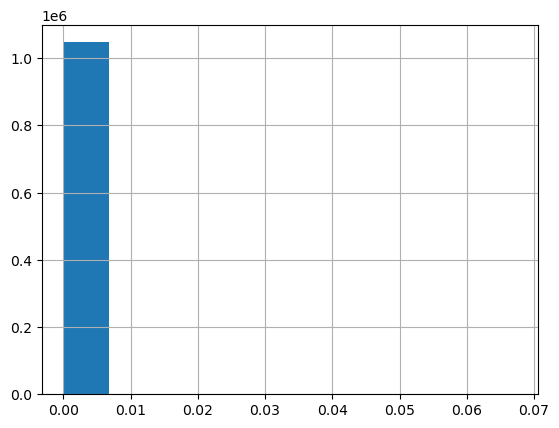

In [183]:
pd.Series(pred_sam.flatten()).hist()

In [187]:
res = spread_px_in_range(pred_sam*100, domain={"dest":(0, 1), "origin":(np.min(pred_sam*100), np.max(pred_sam*100))})

In [191]:
res = res.squeeze()

In [189]:
pd.Series(res.flatten()).describe()

count    1.048576e+06
mean     7.626382e-03
std      1.317154e-02
min      0.000000e+00
25%      5.771144e-03
50%      6.743570e-03
75%      7.702837e-03
max      1.000000e+00
dtype: float64

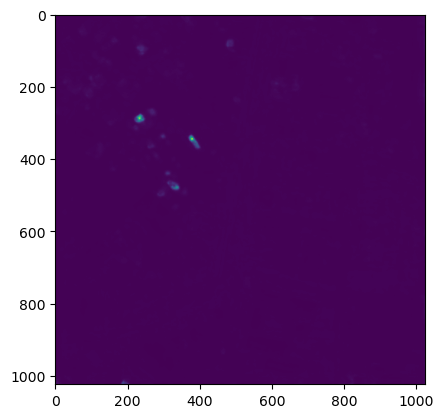

In [192]:
plt.imshow(res)

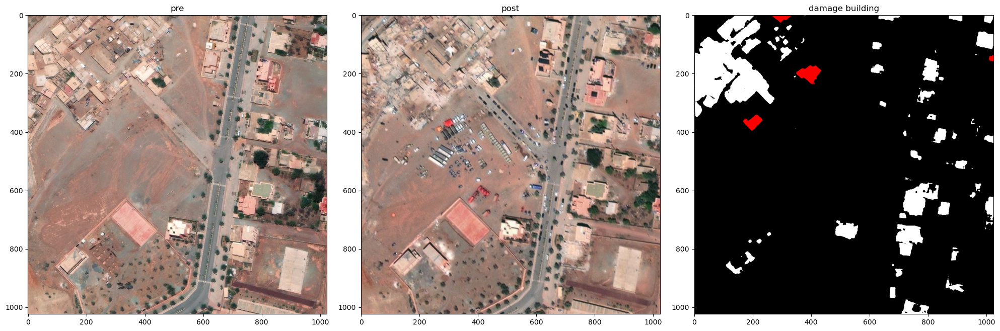

In [22]:
size = 1024

pre_img = rioxr.open_rasterio(pre_path).data.transpose(1, 2, 0)
post_img = rioxr.open_rasterio(post_path).data.transpose(1, 2, 0)
post_img = histogram_alignment(post_img, pre_img)

pre_img = pre_img[:size, :size,:]
post_img = post_img[:size, :size,:]
loc, dam = model(pre_img, post_img)
loc, dam = changeos.visualize(loc, dam)
plt.figure(figsize=(20,20))
for ii, name, img in zip(range(1, 3+1), ["pre", "post", "damage building"], [pre_img, post_img, dam]):
    plt.subplot(1, 3, ii)
    plt.imshow(img)
    plt.title(name)
plt.tight_layout()

### Specs

In [52]:
nearest = load_pickle(Path(interim_dir_path, "visual", "nearest_visual.pkl"))

In [54]:
nearest[nearest.name == town_test]

,before,after,geometry,name,before_view_off_nadir,before_view_azimuth,before_view_incidence_angle,before_view_sun_azimuth,before_view_sun_elevation,after_view_off_nadir,after_view_azimuth,after_view_incidence_angle,after_view_sun_azimuth,after_view_sun_elevation
6,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,"POLYGON ((578144.644 3428529.694, 578144.644 3...",Talat_Nyaaqoub,24.200001,127.400002,63.3,106.8,70.2,24.200001,114.199997,62.7,140.1,57.6


In [53]:
nearest

,before,after,geometry,name,before_view_off_nadir,before_view_azimuth,before_view_incidence_angle,before_view_sun_azimuth,before_view_sun_elevation,after_view_off_nadir,after_view_azimuth,after_view_incidence_angle,after_view_sun_azimuth,after_view_sun_elevation
0,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,"POLYGON ((548109.130 3441774.137, 548109.130 3...",Adassil,28.200001,283.899994,58.8,129.7,75.8,32.700001,305.200012,52.8,154.9,61.8
1,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,"POLYGON ((574171.703 3451395.559, 574171.703 3...",Tafeghaghte,27.900000,74.699997,59.1,163.1,33.7,24.799999,115.000000,61.9,140.3,57.4
2,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,"POLYGON ((548761.849 3442643.085, 548761.849 3...",Mejdid,22.400000,162.600006,65.3,111.3,69.2,32.700001,305.200012,52.8,154.9,61.8
3,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,"POLYGON ((576044.024 3451338.007, 576044.024 3...",Amzi,27.700001,74.599998,59.4,163.1,33.7,24.500000,115.300003,62.3,140.3,57.4
4,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,"POLYGON ((594623.730 3450856.954, 594623.730 3...",Tinzert,14.600000,157.199997,73.9,129.4,67.5,33.299999,281.100006,52.0,156.2,61.9
5,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,"POLYGON ((512235.792 3371060.816, 512235.792 3...",Taroudant,29.200001,187.000000,57.7,155.5,51.2,41.799999,235.199997,41.6,154.6,62.3
6,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,"POLYGON ((578144.644 3428529.694, 578144.644 3...",Talat_Nyaaqoub,24.200001,127.400002,63.3,106.8,70.2,24.200001,114.199997,62.7,140.1,57.6
7,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,"POLYGON ((577287.931 3428148.098, 577287.931 3...",Tassouante,24.200001,127.400002,63.3,106.8,70.2,24.200001,114.199997,62.7,140.1,57.6


#### Reproject match 

In [14]:
pd.Series(dam.flatten()).value_counts()

0    1600316
1      98467
4      22561
Name: count, dtype: int64

In [15]:
distrib = pd.concat([pd.Series(pre_img.flatten(), name="pre_event"), pd.Series(post_img.flatten(), name="post_event")], axis=1)

In [16]:
distrib = distrib.melt(var_name="temp", value_name="dn")

In [17]:
import seaborn as sns

<Axes: xlabel='dn', ylabel='Count'>

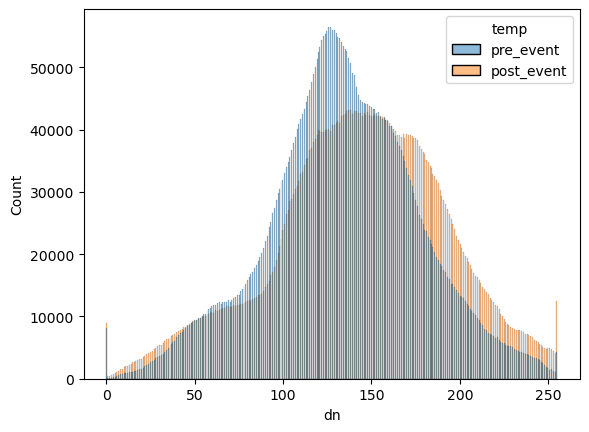

In [18]:
sns.histplot(distrib, x="dn",hue="temp")

In [ ]:
### How much

In [44]:
nearest = get_nearest_match_angle_view(town, type_item="visual", s_bbox=200)

INFO:src.utils:Adassil : found 6 maxar items
INFO:src.utils:Tafeghaghte : found 5 maxar items
INFO:src.utils:Mejdid : found 6 maxar items
INFO:src.utils:Amzi : found 4 maxar items
INFO:src.utils:Tinzert : found 2 maxar items
INFO:src.utils:Taroudant : found 11 maxar items
INFO:src.utils:Talat_Nyaaqoub : found 6 maxar items
INFO:src.utils:Tassouante : found 6 maxar items


In [46]:
nearest["Adassil"]["before"]

,id,type,title,href,datetime,platform,gsd,catalog_id,utm_zone,quadkey,view_off_nadir,view_azimuth,view_incidence_angle,view_sun_azimuth,view_sun_elevation,proj_epsg,grid_code,data_area,clouds_area,clouds_percent,geometry_bbox,after_event,town_name,geometry,intersec_roi_perc
1,29/120202003223/104001004F028F00,image/tiff; application=geotiff; profile=cloud...,Visual Image,https://maxar-opendata.s3.amazonaws.com/events...,2019-07-16 11:53:40Z,WV03,0.38,104001004F028F00,29,120202003223,28.200001,283.899994,58.8,129.7,75.8,32629,MXRA-Z29-120202003223,20.296875,0.099976,0.0,"[544843.75, 3439843.75, 548760.6811523438, 344...",0,Adassil,POLYGON ((547709.1304341872 3441774.1374146263...,1.0


In [47]:
nearest["Adassil"]["after"]

,id,type,title,href,datetime,platform,gsd,catalog_id,utm_zone,quadkey,view_off_nadir,view_azimuth,view_incidence_angle,view_sun_azimuth,view_sun_elevation,proj_epsg,grid_code,data_area,clouds_area,clouds_percent,geometry_bbox,after_event,town_name,geometry,intersec_roi_perc
0,29/120202003223/10300500E4F91500,image/tiff; application=geotiff; profile=cloud...,Visual Image,https://maxar-opendata.s3.amazonaws.com/events...,2023-09-10 11:44:26Z,WV02,0.64,10300500E4F91500,29,120202003223,32.700001,305.200012,52.8,154.9,61.8,32629,MXRA-Z29-120202003223,28.203125,0.0,0.0,"[544843.75, 3439843.75, 550156.25, 3445156.25]",1,Adassil,POLYGON ((547709.1304341872 3441774.1374146263...,1.0


In [48]:
maxar_items = load_maxar_items(type_item="visual")

## Co-registration

## Max Coor

In [4]:
from pathlib import Path

In [14]:
out_dir = Path(project_path, "data", "tmp")

In [15]:
model = changeos.from_name('changeos_r50') # take 'changeos_r101' as example

In [19]:
items_coor = load_pickle(os.path.join(out_dir, f"items_top_corr_roi.pkl"))

In [30]:
items_coor

,town_name,before_path,after_path,corr,geometry
0,43,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,0.930340,POINT (576859.732 3437625.443)
1,86,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,0.930340,POINT (579507.094 3435223.578)
2,158,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,0.930340,POINT (579536.602 3435244.914)
3,42,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,0.930340,POINT (577159.673 3437480.953)
4,43,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,0.924331,POINT (576859.732 3437625.443)
5,42,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,0.924331,POINT (577159.673 3437480.953)
6,86,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,0.924331,POINT (579507.094 3435223.578)
7,158,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,0.924331,POINT (579536.602 3435244.914)
8,28,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,0.913250,POINT (561083.326 3442175.571)
9,33,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,0.913250,POINT (562047.401 3440642.885)


In [104]:
idx = 3
b_path = items_coor.before_path.iloc[idx]
a_path = items_coor.after_path.iloc[idx]
center = items_coor.geometry

In [122]:
pre_img = rioxr.open_rasterio(b_path)
post_img = rioxr.open_rasterio(a_path)

In [119]:
pre_img_repro = pre_img.rio.reproject_match(post_img)

In [123]:
post_img

<xarray.DataArray (band: 3, y: 1967, x: 1967)>
[11607267 values with dtype=uint8]
Coordinates:
  * band         (band) int64 1 2 3
  * x            (x) float64 5.769e+05 5.769e+05 ... 5.775e+05 5.775e+05
  * y            (y) float64 3.438e+06 3.438e+06 ... 3.437e+06 3.437e+06
    spatial_ref  int64 0
Attributes:
    AREA_OR_POINT:  Area
    scale_factor:   1.0
    add_offset:     0.0

In [121]:
pre_img

<xarray.DataArray (band: 3, y: 1967, x: 1967)>
array([[[  0, 190, ...,  90,  87],
        [  0, 188, ...,  94,  96],
        ...,
        [  0, 131, ..., 135, 131],
        [  0,   0, ...,   0,   0]],

       [[  0, 163, ...,  80,  77],
        [  0, 161, ...,  84,  86],
        ...,
        [  0, 110, ..., 127, 123],
        [  0,   0, ...,   0,   0]],

       [[  0, 142, ...,  71,  68],
        [  0, 140, ...,  75,  77],
        ...,
        [  0,  89, ..., 106, 102],
        [  0,   0, ...,   0,   0]]], dtype=uint8)
Coordinates:
  * band         (band) int64 1 2 3
  * x            (x) float64 5.769e+05 5.769e+05 ... 5.775e+05 5.775e+05
  * y            (y) float64 3.438e+06 3.438e+06 ... 3.437e+06 3.437e+06
    spatial_ref  int64 0
Attributes:
    AREA_OR_POINT:             Area
    STATISTICS_APPROXIMATE:    YES
    STATISTICS_MAXIMUM:        255
    STATISTICS_MEAN:           100.67318533582
    STATISTICS_MINIMUM:        0
    STATISTICS_STDDEV:         56.671734763981
    STATISTICS_VALID_PERCENT:  100
    scale_factor:              1.0
    add_offset:                0.0

In [120]:
pre_img_repro

<xarray.DataArray (band: 3, y: 1967, x: 1967)>
array([[[  0, 190, 182, ...,  94,  90,  87],
        [  0, 188, 181, ...,  92,  94,  96],
        [  0, 183, 178, ...,  93,  93,  95],
        ...,
        [  0, 123, 125, ..., 138, 131, 130],
        [  0, 131, 133, ..., 144, 135, 131],
        [  0,   0,   0, ...,   0,   0,   0]],

       [[  0, 163, 155, ...,  84,  80,  77],
        [  0, 161, 154, ...,  82,  84,  86],
        [  0, 156, 151, ...,  83,  83,  85],
        ...,
        [  0, 102, 103, ..., 130, 123, 122],
        [  0, 110, 111, ..., 133, 127, 123],
        [  0,   0,   0, ...,   0,   0,   0]],

       [[  0, 142, 134, ...,  75,  71,  68],
        [  0, 140, 133, ...,  73,  75,  77],
        [  0, 135, 130, ...,  74,  74,  76],
        ...,
        [  0,  81,  82, ..., 109, 104, 103],
        [  0,  89,  90, ..., 113, 106, 102],
        [  0,   0,   0, ...,   0,   0,   0]]], dtype=uint8)
Coordinates:
  * band         (band) int64 1 2 3
    spatial_ref  int64 0
  * x            (x) float64 5.769e+05 5.769e+05 ... 5.775e+05 5.775e+05
  * y            (y) float64 3.438e+06 3.438e+06 ... 3.437e+06 3.437e+06
Attributes:
    AREA_OR_POINT:             Area
    STATISTICS_APPROXIMATE:    YES
    STATISTICS_MAXIMUM:        255
    STATISTICS_MEAN:           100.67318533582
    STATISTICS_MINIMUM:        0
    STATISTICS_STDDEV:         56.671734763981
    STATISTICS_VALID_PERCENT:  100
    scale_factor:              1.0
    add_offset:                0.0
    _FillValue:                255

In [107]:
s_buffer = 100

In [108]:
shape = box(*items_coor.geometry.buffer(s_buffer).iloc[idx].bounds)

In [109]:
pre_img = crop_rs_on_shape(b_path, shape)
post_img = crop_rs_on_shape(a_path, shape)

In [110]:
pre_img = pre_img.transpose(1, 2, 0)
post_img = post_img.transpose(1, 2, 0)

In [116]:
b_path

'/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/tmp/3_300_103001008244DA00-visual.tif'

In [111]:
center_h = pre_img.shape[0] // 2
center_w = pre_img.shape[1] // 2

SIZE = 512
pre_img = pre_img[
    center_h - (SIZE//2):center_h + (SIZE//2),
    center_w - (SIZE//2):center_w + (SIZE//2),
]

post_img = post_img[
    center_h - (SIZE//2):center_h + (SIZE//2),
    center_w - (SIZE//2):center_w + (SIZE//2),
]

In [112]:
pre_img.shape

(512, 512, 3)

In [113]:
loc, dam = model(pre_img, post_img)

In [114]:
pd.Series(dam.flatten()).value_counts()

0    239484
1     22273
4       387
Name: count, dtype: int64

size : 512


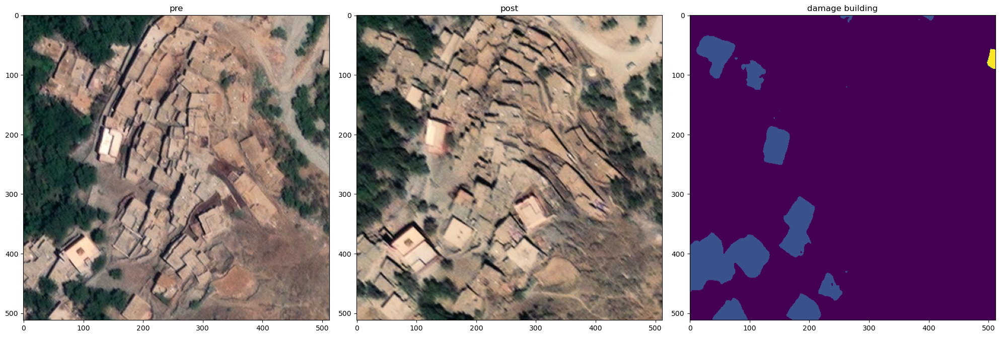

In [115]:
plt.figure(figsize=(20,20))
for ii, name, img in zip(range(1, 3+1), ["pre", "post", "damage building"], [pre_img, post_img, dam]):
    plt.subplot(1, 3, ii)
    plt.imshow(img)
    plt.title(name)
plt.tight_layout()
print(f"size : {SIZE}")

size : 512


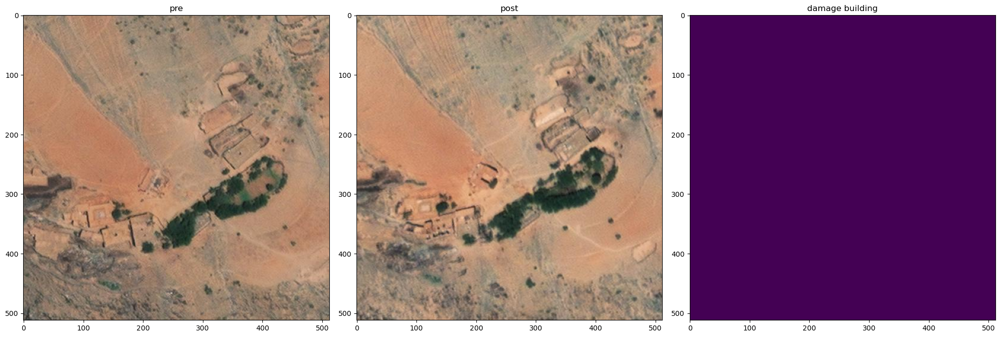

In [91]:
plt.figure(figsize=(20,20))
for ii, name, img in zip(range(1, 3+1), ["pre", "post", "damage building"], [pre_img, post_img, dam]):
    plt.subplot(1, 3, ii)
    plt.imshow(img)
    plt.title(name)
plt.tight_layout()
print(f"size : {SIZE}")

size : 512


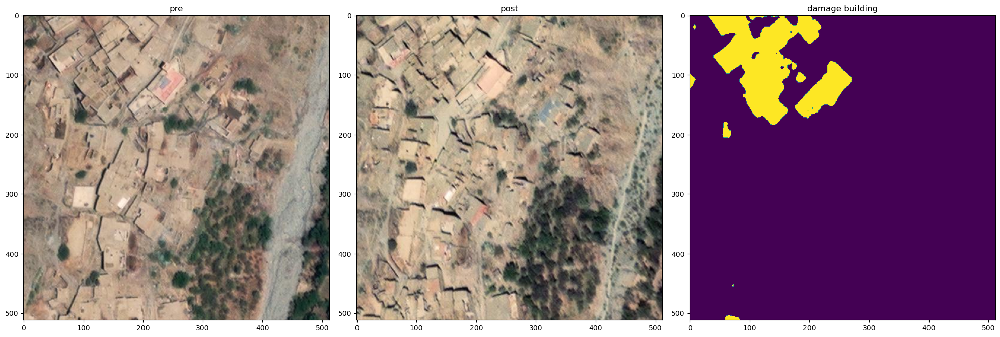

In [68]:
plt.figure(figsize=(20,20))
for ii, name, img in zip(range(1, 3+1), ["pre", "post", "damage building"], [pre_img, post_img, dam]):
    plt.subplot(1, 3, ii)
    plt.imshow(img)
    plt.title(name)
plt.tight_layout()
print(f"size : {SIZE}")

Buffer : 200


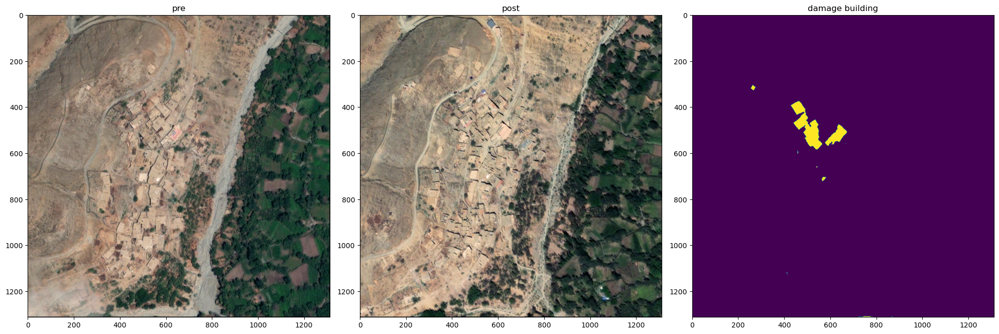

In [44]:
plt.figure(figsize=(20,20))
for ii, name, img in zip(range(1, 3+1), ["pre", "post", "damage building"], [pre_img, post_img, dam]):
    plt.subplot(1, 3, ii)
    plt.imshow(img)
    plt.title(name)
plt.tight_layout()
print(f"Buffer : {s_buffer}")